# Comparing rabbit and mouse gastrulation using neighbourhoods

<b> Daniel Keitley </b>

In this notebook, we compare our rabbit scRNA-seq dataset with a similarly generated atlas of mouse gastrulation to explore which cell states and developmental trajectories are transcriptionally similar or dissimilar between the two species. 

To compare the two datasets, we compute the correlation in gene expression between neighbourhoods of cells, which locally approximate gene expression signatures across the k-NN graphs of each atlas. 


## Load data

We first load the rabbit and mouse datasets along with a dataframe of rabbit-mouse one-to-one ortholog genes. 

In [50]:
# Load packages
suppressPackageStartupMessages(library(scrabbitr))
suppressPackageStartupMessages(library(SingleCellExperiment))
suppressPackageStartupMessages(library(miloR))
suppressPackageStartupMessages(library(DelayedArray))
suppressPackageStartupMessages(library(Matrix))
suppressPackageStartupMessages(library(ggraph))
suppressPackageStartupMessages(library(igraph))
suppressPackageStartupMessages(library(viridis))
suppressPackageStartupMessages(library(gridExtra))
suppressPackageStartupMessages(library(RColorBrewer))
suppressPackageStartupMessages(library(jsonlite))
suppressPackageStartupMessages(library(ggrastr))
suppressPackageStartupMessages(library(ggridges))
suppressPackageStartupMessages(library(ggalluvial))
suppressPackageStartupMessages(library(ggrepel))

# TODO: Remove
source("../data-in/rabbit/load_rabbit.R")
source("../scrabbitr/R/plot_utils.R") #temp

In [248]:
# Load rabbit data
r_data <- loadRabbitData()
r_data

class: SingleCellExperiment 
dim: 30725 146133 
metadata(0):
assays(2): counts logcounts
rownames(30725): ENSOCUG00000014251 ENSOCUG00000005054 ...
  ENSG00000175602 ENSG00000172324
rowData names(1): V1
colnames(146133): cell_1 cell_2 ... cell_172994 cell_172995
colData names(14): cell barcode ... sizeFactor celltype
reducedDimNames(3): UMAP TSNE PCA
altExpNames(0):

<br>
The 10X mouse data used for this analysis (Ross-Handler et al. 2022) was generated from mouse embryos spanning embryonic stages E6.5 - E9.5 sampled at 6 hour intervals. This overlaps the developmental stages profiled in the rabbit. The total atlas consists of 430,339 cells and can be accessed [here](https://marionilab.github.io/ExtendedMouseAtlas/).

In [145]:
# Load mouse data
m_data <- readRDS("../data-in/mouse/integrated_sce.rds")
m_data

class: SingleCellExperiment 
dim: 23972 430339 
metadata(0):
assays(2): counts logcounts
rownames(23972): ENSMUSG00000001138 ENSMUSG00000001143 ...
  ENSMUSG00000108929 ENSMUSG00000109022
rowData names(0):
colnames(430339): cell_1 cell_2 ... ext_cell_351871 ext_cell_351872
colData names(0):
reducedDimNames(0):
altExpNames(0):

In [146]:
# TODO: Remove
m_pcs <- readRDS("../data-in/mouse/integrated_corrected_pcs.rds")
reducedDim(m_data,"PCA") <- as.matrix(m_pcs)

m_meta <- read.table("../data-in/mouse/meta.tsv",sep="\t")
m_data$celltype <- m_meta$celltype.clustering

m_meta2 <- readRDS("../data-in/mouse/integrated_metadata.rds")
reducedDim(m_data,"UMAP") <- m_meta2[,c("BBKNN_UMAP1","BBKNN_UMAP2")]

m_genes <- read.table("../data-in/mouse/genes.tsv", sep="\t")


<br>
We also load a dataframe of one-to-one ortholog genes between the rabbit and mouse. This allows us to relate the gene features across the two species. These were previously obtained using Ensembl biomaRt. 

In [9]:
# Load rabbit-mouse one-to-one orthologs
rm_orthologs <- read.table("../data-in/orthologs/mmusculus.tsv",sep="\t")
rm_orthologs[1:5,]

,ref,query
,<chr>,<chr>
ENSOCUG00000000006,ENSOCUG00000000006,ENSMUSG00000026102
ENSOCUG00000000007,ENSOCUG00000000007,ENSMUSG00000028480
ENSOCUG00000000008,ENSOCUG00000000008,ENSMUSG00000070999
ENSOCUG00000000009,ENSOCUG00000000009,ENSMUSG00000028478
ENSOCUG00000000010,ENSOCUG00000000010,ENSMUSG00000028479


## Compute neighbourhoods

To define neighbourhoods of cells across the rabbit and mouse datasets, we make use of the miloR package (Dann et al. 2021). 

The miloR package conveniently operates on Milo objects, which extend the rabbit and mouse SingleCellExperiment objects to store and manipulate information about neighbourhoods. 

We call the `buildGraph` function to create a k-NN graph on the corrected principal components, and then run `makeNhoods` to define the overlapping neighbourhoods. We use a sampling proportion (`prop`) of 0.05 due to the large number of cells in each dataset. See the miloR vignettes for more details. 

### Rabbit

In [ ]:
# Compute rabbit neighbourhoods
r_milo <- Milo(r_data)
r_milo <- buildGraph(r_milo, k=30, d=50, reduced.dim="PCA")
r_milo <- makeNhoods(r_milo, prop=0.05, k=30, d=50,refined=T, reduced_dims="PCA")

In [ ]:
r_milo <- buildNhoodGraph(r_milo)

In [2]:
# Export miloR object
#writeMM(r_milo@nhoods,"../data-out/compare_nhoods/r_nhoods.mtx")
#saveRDS(r_milo,"../data-out/compare_nhoods/r_milo.rds")

In [1]:
# Load exported milo objects
r_milo <- readRDS("../data-out/compare_nhoods/r_milo.rds")
r_milo

Loading required package: miloR

Loading required package: edgeR

Loading required package: limma



class: Milo 
dim: 30725 146133 
metadata(0):
assays(2): counts logcounts
rownames(30725): ENSOCUG00000014251 ENSOCUG00000005054 ...
  ENSG00000175602 ENSG00000172324
rowData names(2): ensembl_id gene_name
colnames(146133): cell_1 cell_2 ... cell_172994 cell_172995
colData names(17): cell barcode ... dissection cellltype_old
reducedDimNames(4): UMAP TSNE PCA FA
altExpNames(0):
nhoods dimensions(2): 146133 5253
nhoodCounts dimensions(2): 1 1
nhoodDistances dimension(1): 0
graph names(1): graph
nhoodIndex names(1): 5253
nhoodExpression dimension(2): 1 1
nhoodReducedDim names(0):
nhoodGraph names(1): nhoodGraph
nhoodAdjacency dimension(2): 5253 5253

<br>
After creating the neighbourhoods we can plot the number of cells in each neighbourhood as a distribution and visualise them across the UMAP embedding. The `buildNhoodGraph` function above builds an abstracted graph which shows the overlap between neighbourhoods. 

Warning message in plotNhoodGraph(r_milo, size_range = c(0.1, 3), node_stroke = 0.1):
“Coercing layout to matrix format”
Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



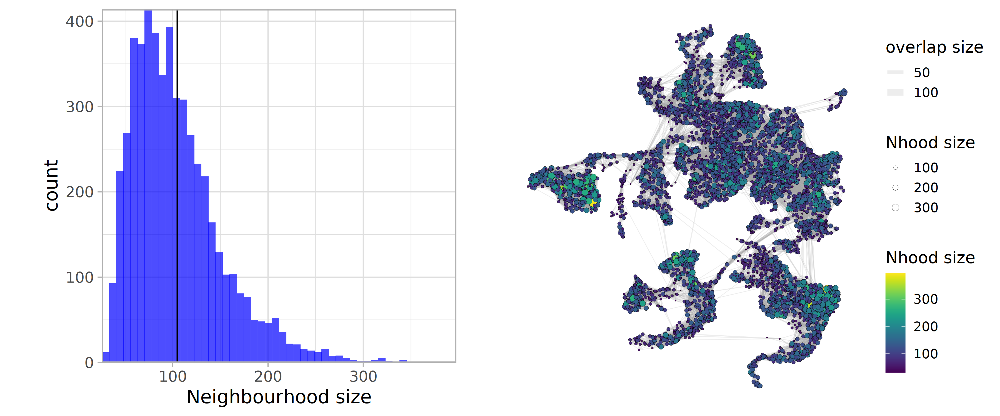

In [15]:
options(repr.plot.width = 12, repr.plot.height = 5, repr.plot.res = 300)

p1 <- scrabbitr::plotNhoodSizeHist(r_milo, colour="blue")
#ggsave("../plots/compare_nhoods/r_milo_nhood_size_hist.pdf", p1, width=4, height=4, dpi=300)

p2 <- plotNhoodGraph(r_milo, size_range=c(0.1,3), node_stroke=0.1) + 
scale_fill_viridis(name = "Nhood size", option = "viridis", direction = 1) 
#ggsave("../plots/compare_nhoods/r_nhood_size_graph.pdf", p2, width=6, height=5, dpi=300)

grid.arrange(p1, p2, nrow=1)

### Mouse

We perform the same steps to create neighbourhoods across the mouse k-NN graph. 

In [29]:
# Compute mouse neighbourhoods
m_milo <- Milo(m_data)
m_milo <- buildGraph(m_milo, k=30, d=50, reduced.dim="PCA")
m_milo <- makeNhoods(m_milo, prop=0.05, k=30, d=50,refined=T, reduced_dims="PCA")

Constructing kNN graph with k:30

Checking valid object



In [ ]:
m_milo <- buildNhoodGraph(m_milo)

In [3]:
m_milo <- readRDS("../data-out/compare_nhoods/m_milo.rds")
m_milo

class: Milo 
dim: 23972 430339 
metadata(0):
assays(2): counts logcounts
rownames(23972): ENSMUSG00000001138 ENSMUSG00000001143 ...
  ENSMUSG00000108929 ENSMUSG00000109022
rowData names(2): ensembl_id gene_name
colnames(430339): cell_1 cell_2 ... ext_cell_351871 ext_cell_351872
colData names(4): celltype stage dissection somite_count
reducedDimNames(3): PCA UMAP FA
altExpNames(0):
nhoods dimensions(2): 430339 14034
nhoodCounts dimensions(2): 1 1
nhoodDistances dimension(1): 0
graph names(1): graph
nhoodIndex names(1): 14034
nhoodExpression dimension(2): 1 1
nhoodReducedDim names(0):
nhoodGraph names(1): nhoodGraph
nhoodAdjacency dimension(2): 14034 14034

In [15]:
# Export mouse miloR object
#saveRDS(m_milo,"../data-out/compare_nhoods/m_milo.rds")
#saveRDS(m_milo@nhoods,"../data-out/compare_nhoods/m_nhoods.rds")
#writeMM(m_milo@nhoods,"../data-out/compare_nhoods/m_nhoods.mtx")

Warning message in plotNhoodGraph(m_milo, size_range = c(0.1, 3), node_stroke = 0.1):
“Coercing layout to matrix format”
Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



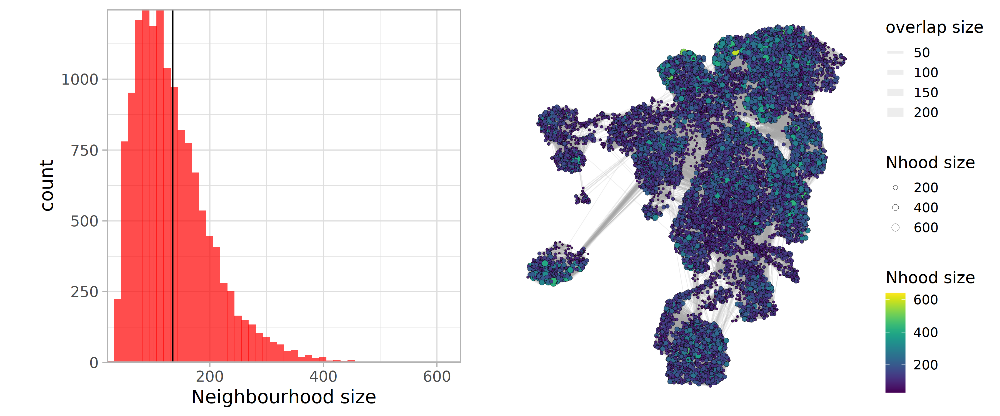

In [20]:
# Plot nhoods and size distribution
options(repr.plot.width = 12, repr.plot.height = 5, repr.plot.res = 300)

p1 <- plotNhoodSizeHist(m_milo, colour="red")
#ggsave("../plots/compare_nhoods/m_milo_nhood_size_hist.pdf", p1, width=4, height=4, dpi=300)

p2 <- plotNhoodGraph(m_milo,size_range=c(0.1,3) ,node_stroke=0.1) + 
scale_fill_viridis(name = "Nhood size", option = "viridis", direction=1)
#ggsave("../plots/compare_nhoods/m_nhood_size_graph.pdf", p2, width=6, height=5, dpi=300)

grid.arrange(p1, p2, nrow = 1)


In [ ]:
# TODO: Remove

# Add missing info to milo objects

# Add gene names
m_genes <- read.table("../data-in/mouse/genes.tsv", sep="\t")
rownames(m_genes) <- m_genes$ensembl_id
rownames(m_milo) <- m_genes$ensembl_id
rowData(m_milo) <- m_genes

# Add rabbit rowData
r_genes <- read.table("../data-in/rabbit/genes.tsv", sep="\t")
rownames(r_genes) <- r_genes$ensembl_id
rowData(r_milo) <- r_genes

# Add mouse colData
m_meta <- read.table("../data-in/mouse/meta.tsv", sep="\t")
m_milo$stage <- m_meta$stage
m_milo$dissection <- m_meta$tube_name_corrected
m_milo$somite_count <- m_meta$somite_count


# Add somite/dissection info
r_milo$somite_count <- 0
r_milo$somite_count[r_milo$sample %in% c(7,8,9)] <- 4
r_milo$somite_count[r_milo$sample %in% c(12,13,14,15)] <- 13
r_milo$somite_count[r_milo$sample %in% c(16,17,18,19)] <- 16
r_milo$somite_count[r_milo$sample %in% c(20,21,22)] <- 11
r_milo$somite_count[r_milo$sample %in% c(23,24,25,26)] <- 19
r_milo$somite_count[r_milo$sample %in% c(1,2,3,4,5,6,10,11)] <- 0

r_milo$dissection <- "Undetermined"
r_milo$dissection[r_milo$sample %in% c(12,16)] <- "Anterior_section"
r_milo$dissection[r_milo$sample %in% c(13,17)] <- "Mid_section"
r_milo$dissection[r_milo$sample %in% c(14,18)] <- "Posterior_section"
r_milo$dissection[r_milo$sample %in% c(20,21,23,24,25)] <- "EP"
r_milo$dissection[r_milo$sample %in% c(15,19,22,26)] <- "YS"

m_force <- read.table("../data-out/vis/mouse/force_atlas.tsv",sep="\t")
m_force <- apply(m_force, MARGIN = 2, FUN = function(X) (X - min(X))/diff(range(X)))              
reducedDim(m_milo,"FA") <- m_force 
                 
# Update rabbit cell types
r_celltypes <- read.table("../data-in/celltype_annotation/annotations_08-03-22.tsv",sep="\t",row.names=1, header=TRUE)
r_milo$cellltype_old <- r_milo$celltype
r_milo$celltype <- r_celltypes$assigned_celltype
head(r_milo$celltype)

## Run neighbourhood comparison pipeline

Having defined neighbourhoods in both the rabbit and mouse dataset, we can now compute the similarity in gene expression between all neighbourhoods of both species. A full description of the analysis steps can be found in the methods section of the paper. 

Broadly, the pipeline consists of three steps. 

**Feature selection** <br>
The first step is to select which gene features are used to compare transcriptional profiles. Here, by default, we select the top 2000 highly variable genes from each species (excluding mitochondrial and cell-cycle related genes), filter those that are rabbit-mouse one-to-one orthologs and then take the intersection between the two lists. 

**Compute an average expression profile** <br>
Next, we compute a mean expression profile across the cells of each neighbourhood using the set of common features. 

**Calculate neighbourhood correlations** <br>
The third step is to compute the Pearson correlation between the mean profiles all rabbit and mouse neighbourhoods. We also take an additional step prior to this, to reduce the effect of absolute values. Specifically, we calculate the gene specificity within each neighbourhood. The details of this can be found in the paper methods. 
<br>

Many aspects of the pipeline can be tweaked using the arguments of `calcNhoodSim`. Here we specify parameters used in the original analysis.  Run `?scrabbitr::calcNhoodSim` for more details. 


In [47]:
# Run pipeline
out <- scrabbitr::calcNhoodSim(r_milo, m_milo, rm_orthologs, sim_preprocessing="gene_spec", sim_measure="pearson",
                               hvg_join_type="intersection", max_hvgs=2000, r_exclude = r_exclude, m_exclude = m_exclude,
                               export_dir = "../data-out/compare_nhoods/nhood_comparisons/intersect_2000_pearson_w_gspec_exclude_cc_mito/", 
                               verbose = TRUE)

Selecting features...

Combining features...

Averaging expression across neighbourhoods...

Computing similarity across neighbourhoods...

Exporting results...



The `calcNhoodSim` pipline outputs a list containing three objects:

`nhood_sim` - a matrix of similarity values computed between all rabbit (rows) and mouse (columns) neighbourhoods 

`r_vals` / `m_vals` - the gene specificity value (or raw mean expression) for each gene (rows) in each rabbit/mouse neighbourhood. 

In [9]:
# Load exported results
nhood_sim <- as.matrix(fread("../data-out/compare_nhoods/nhood_comparisons/intersect_2000_pearson_w_gspec_exclude_cc_mito/nhood_sim.tsv", sep="\t"), rownames=1)
r_vals <- fread("../data-out/compare_nhoods/nhood_comparisons/intersect_2000_pearson_w_gspec_exclude_cc_mito/r_vals.tsv", sep="\t")
m_vals <- fread("../data-out/compare_nhoods/nhood_comparisons/intersect_2000_pearson_w_gspec_exclude_cc_mito/m_vals.tsv", sep="\t")
out <- list(r_vals = r_vals, m_vals = m_vals, nhood_sim = nhood_sim)

nhood_sim[1:5,1:5]

Warning message in fread("../data-out/compare_nhoods/nhood_comparisons/intersect_2000_pearson_w_gspec_exclude_cc_mito/nhood_sim.tsv", :
“Detected 14034 column names but the data has 14035 columns (i.e. invalid file). Added 1 extra default column name for the first column which is guessed to be row names or an index. Use setnames() afterwards if this guess is not correct, or fix the file write command that created the file to create a valid file.”
Warning message in fread("../data-out/compare_nhoods/nhood_comparisons/intersect_2000_pearson_w_gspec_exclude_cc_mito/r_vals.tsv", :
“Detected 5253 column names but the data has 5254 columns (i.e. invalid file). Added 1 extra default column name for the first column which is guessed to be row names or an index. Use setnames() afterwards if this guess is not correct, or fix the file write command that created the file to create a valid file.”
Warning message in fread("../data-out/compare_nhoods/nhood_comparisons/intersect_2000_pearson_w_gspec_e

,247238,14403,203858,232515,358972
57511,0.8647116,0.4613815,0.8188003,0.7939592,0.7901731
104077,0.8258050,0.4669510,0.8577902,0.8489962,0.8344394
30659,0.7477993,0.5404564,0.7620981,0.7179571,0.7392555
19736,0.4192233,0.6896652,0.4264303,0.3989742,0.4271284
73244,0.8135123,0.4912851,0.8390272,0.7921172,0.8256318


In [30]:
# Extract neighbourhood graph
r_graph <- nhoodGraph(r_milo)
m_graph <- nhoodGraph(m_milo)

# Add nhood attributes to igraph
r_nhoodIDs <- as.numeric(vertex_attr(r_graph)$name) 
r_indCells <- colnames(r_milo)[r_nhoodIDs]

V(r_graph)$cell_name <- r_indCells
V(r_graph)$celltype <- colData(r_milo)[r_indCells, "celltype"]

m_nhoodIDs <- as.numeric(vertex_attr(m_graph)$name) 
m_indCells <- colnames(m_milo)[m_nhoodIDs]

V(m_graph)$cell_name <- m_indCells
V(m_graph)$celltype <- colData(m_milo)[m_indCells, "celltype"]

## Visualise results

Although we have computed similarity in gene expression across all rabbit and mouse neighbourhoods, it can be useful to plot only the values between maximally correlated pairs of neighbourhoods. This can be computed separately in the rabbit-mouse direction (for each rabbit neighbourhood, identify the maximum correlation with any mouse neighbourhood) and vice-versa, in the mouse-rabbit direction. This allows us to visualise where the two species are most similar or different across the two UMAP embeddings.

Here, each point represents a neighbourhood, positioned according to the UMAP embedding of its index cell. 

In [11]:
# Calculate maximum correlations  
r_maxNhoods <- getMaxMappings(out$nhood_sim, 1, long_format=FALSE) # rabbit-mouse
m_maxNhoods <- getMaxMappings(out$nhood_sim, 2, long_format=FALSE) # mouse-rabbit
df_simFilt <- rbind(r_maxNhoods, m_maxNhoods)

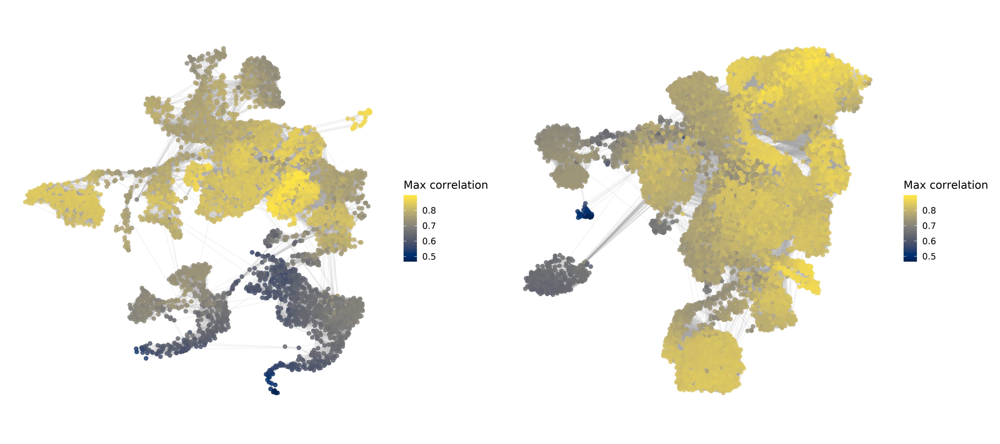

In [15]:
options(repr.plot.width = 18, repr.plot.height = 8, repr.plot.res = 300)
p1 <- plotNhoodMaxSim(r_milo, r_maxNhoods)
p2 <- plotNhoodMaxSim(m_milo, m_maxNhoods)
grid.arrange(p1,p2,nrow=1)

# ggsave("../plots/compare_nhoods/r_max_corr.pdf", p1, width=10, height=8, dpi=300)
# ggsave("../plots/compare_nhoods/m_max_corr.pdf", p2, width=10, height=8, dpi=300)

An advantage of using a neighbourhood-based comparison is that it is agnostic of the cell type annotations. However, we are able to refer back to cell type labels by aggregating correlation values by the cell type label (or any other observations) associated with each index cell. Below we plot the distribution of maximum correlation values across neighbourhoods of certain cell types.  

Picking joint bandwidth of 0.00417



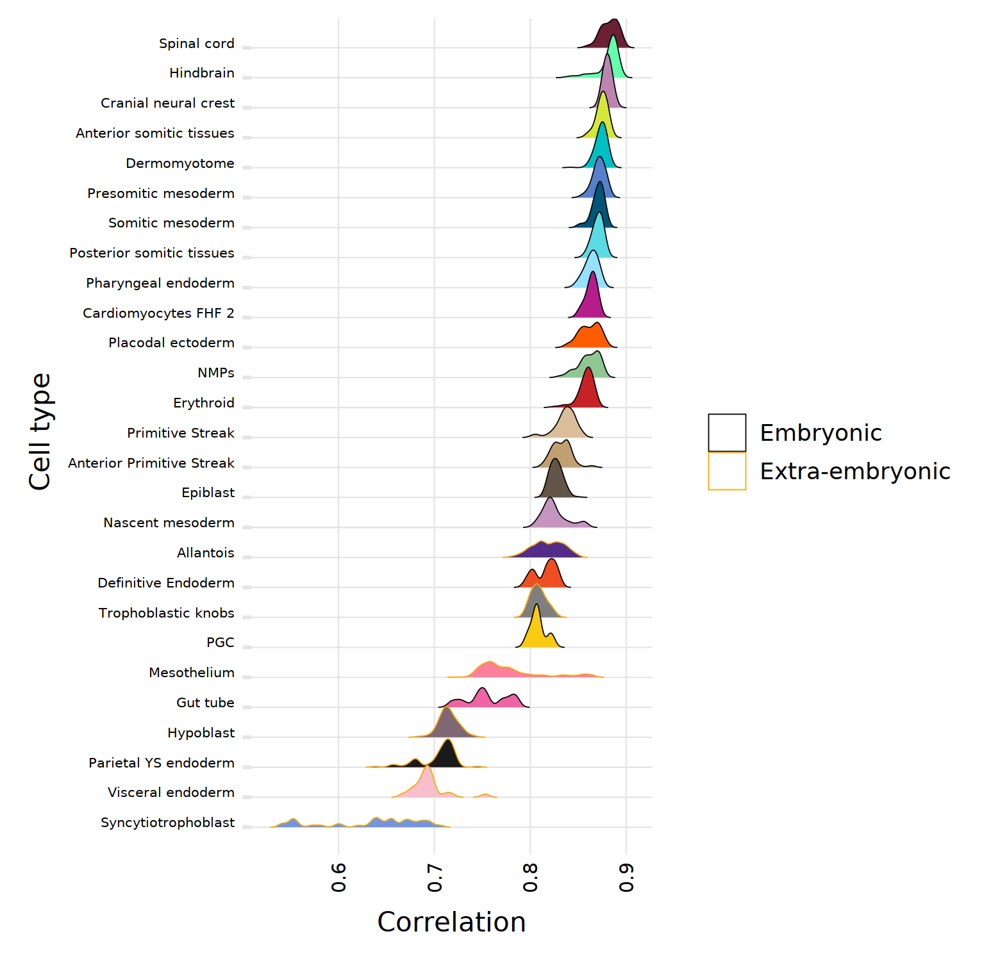

In [39]:
options(repr.plot.width = 5.2, repr.plot.height = 5, repr.plot.res = 300)

# Highlight extra-embryonic cell types
exe_celltypes <- c("Syncytiotrophoblast", "Cytotrophoblast", "Parietal YS endoderm", "Hypoblast", "Visceral endoderm", "Visceral YS endoderm 2", "Trophoblastic knobs", "Visceral YS endoderm",
          "Syncytiotrophoblast progenitors", "Trophoblast","Mesothelium", "Non-neural ectoderm 2", "Mesothelium-endothelium/Masked", "Mesenchyme", "Allantois endothelium",
          "Allantois","YS endothelium", "Mesothelium-endothelium/Masked")
r_milo$isExE <- ifelse(r_milo$celltype %in% exe_celltypes,"Extra-embryonic", "Embryonic")


p <- plotNhoodSimGroups(r_milo, r_maxNhoods$sim, xlabel="Correlation", ylabel="Cell type",colour_by="isExE",size=0.15, 
                        rel_min_height=0.001, show_rank = FALSE, 
                        subset=c("Cardiomyocytes FHF 2", "Presomitic mesoderm", "Anterior somitic tissues",
                                "Syncytiotrophoblast","Parietal YS endoderm", "Hypoblast", "Visceral endoderm",
                                "Gut tube", "Trophoblastic knobs", "Mesothelium","Allantois","Epiblast","PGC",
                                "Anterior Primitive Streak","Definitive Endoderm", "Nascent mesoderm",
                                "Somitic mesoderm","Hindbrain", "NMPs","Dermomyotome","Spinal cord", "Pharyngeal endoderm",
                                "Placodal ectoderm","Cranial neural crest","Primitive Streak","Posterior somitic tissues",
                                "Erythroid"))

p <- p + scale_color_manual(values=c("black","orange")) + 
    theme(text = element_text(size=10),
          axis.text = element_text(size=7), 
          axis.ticks = element_line(size = 0.2),
          panel.grid.minor = element_line(size = 0.1), 
          panel.grid.major = element_line(size = 0.2)) 
p
#ggsave("../plots/compare_neighbourhoods/r_nhoods_celltype_ranked_subset_isExE_thinner.pdf",p, width=5.2, height=5, dpi=300)

Similarly, we can look at the distribution of maximum correlation values acros samples or stages. 

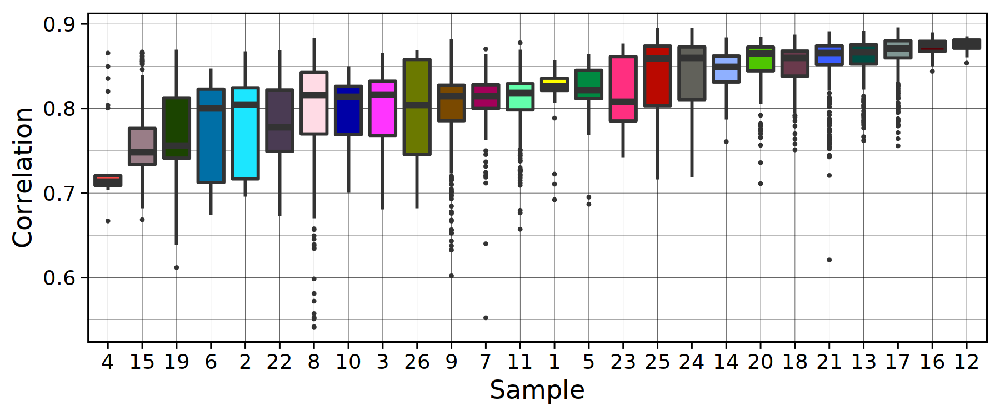

In [16]:
options(repr.plot.width = 6, repr.plot.height = 2.5, repr.plot.res = 300)

sample_pal <- scrabbitr::getDiscreteColours(unique(r_milo$sample))
names(sample_pal) <- unique(r_milo$sample)

p <- scrabbitr::plotNhoodSimGroups(r_milo, r_maxNhoods$sim, xlabel="Correlation", group_by="sample", group_colours = sample_pal,
                        ylabel="Sample", type="boxplot", orientation = "horizontal", size=0.1, rel_min_height=0.001) + 
    theme(axis.text.y = element_text(size=12),
         axis.text.x = element_text(size=12)) + theme_linedraw()
p

#ggsave("../plots/compare_nhoods/sample_boxplot.pdf", p, width=6, height=2.5, dpi=300)

Picking joint bandwidth of 0.0101



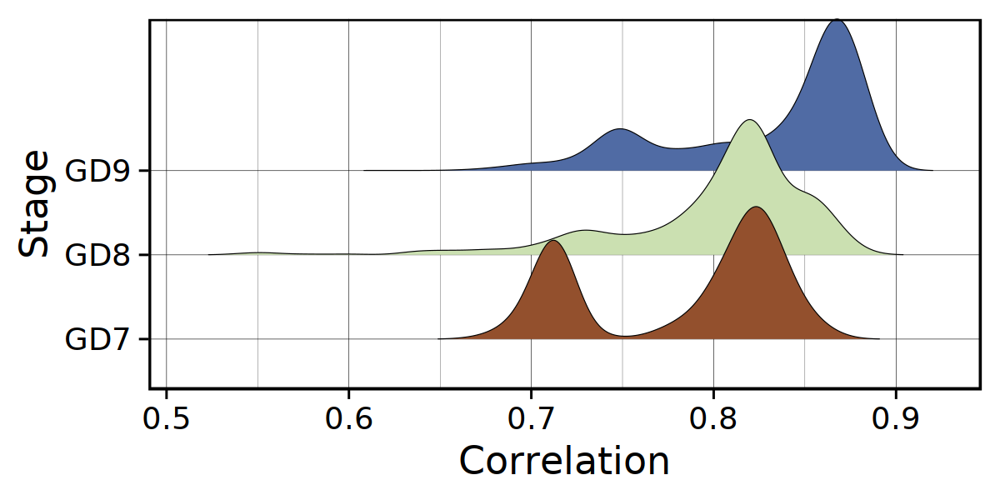

In [14]:
options(repr.plot.width = 4, repr.plot.height = 2, repr.plot.res = 300)

p <- plotNhoodSimGroups(r_milo, r_maxNhoods$sim, xlabel="Correlation", group_by="stage",
                        group_colours=scrabbitr::getStageColours(), ylabel="Stage", size=0.1, rel_min_height=0.001) + 
    theme(axis.text.y = element_text(size=12),
         axis.text.x = element_text(size=12)) + theme_linedraw()
p

#ggsave("../plots/compare_nhoods/stage_ridgeline.pdf", p, width=4, height=2, dpi=300)

### Developmental trajectories

A second advantage is that neighbourhoods effectively capture variation in gene expression along developmental trajectories. To visualise similarities and differences between species along various differentiation trajectories, we can highlight maxmally correlated pairs of neighbourhoods in the UMAP embeddings of the two datasets. 

Here, we use `plotTrajMappings` to connect maxmially correlated neighbourhoods across the low-dimensional embeddings of the two species for subsets of different cell types. The positioning of the UMAPs can be tweaked using the `offset`, `reflect.X`, `reflect.Y` parameters. You can also specify the low-dimensional embedding with `dimred` and colouring with `colour_by`. See `?plotTrajMappings` for more details.

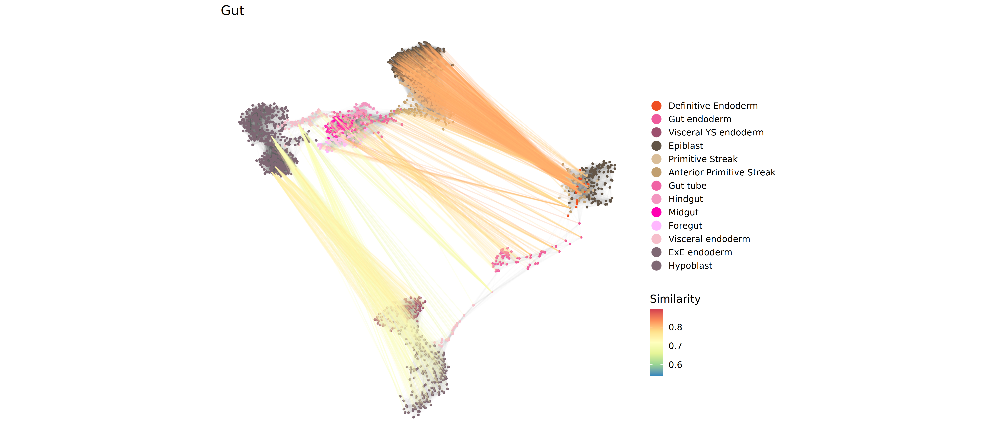

In [8]:
options(repr.plot.width = 18, repr.plot.height = 8, repr.plot.res = 300)

gut_celltypes <- c("Visceral endoderm","ExE endoderm", "Midgut", "Gut tube","Primitive Streak", 
               "Epiblast","Foregut", "Hindgut","Definitive Endoderm","Anterior Primitive Streak",
              "Hypoblast","Visceral YS endoderm","Gut endoderm","Def. Endoderm")

p_gut <- plotTrajMappings(r_milo, m_milo, df_simFilt, 
                               group="celltype", groups=gut_celltypes, 
                               dimred="UMAP",
                               offset=c(0,1),line_alpha=0.2,edge_alpha=0.01, 
                               reflect.X=FALSE, legend_pos="right") +
    guides(fill = guide_legend(override.aes = list(size=6))) + ggtitle("Gut")

p_gut
#ggsave("../plots/compare_nhoods/gut_mapping.pdf", p_gut, width=18, height=8, dpi=300)

In [9]:
# Mesoderm
meso_celltypes <- c("Sclerotome","Dermomyotome", "Somitic mesoderm", "Anterior somitic tissues",
               "Posterior somitic tissues","Cranial mesoderm","Anterior Primitive Streak",
               "Caudal epiblast","Paraxial mesoderm","Intermediate mesoderm","Epiblast",
               "Primitive Streak","Presomitic mesoderm","NMPs","NMPs/Mesoderm-biased",
              "Caudal mesoderm", "Nascent mesoderm")

p_meso <- plotTrajMappings(r_milo, m_milo, df_simFilt, 
                            group="celltype", groups=meso_celltypes, 
                            dimred="UMAP", offset=c(20,20), reflect.X=TRUE,
                            line_alpha=0.1,edge_alpha=0.01, 
                            legend_pos="right") + guides(fill = guide_legend(override.aes = list(size=6))) +
                            ggtitle("Mesoderm")
#ggsave("../plots/compare_nhoods/meso_mapping.pdf", p_meso, width=18, height=8, dpi=300)

In [10]:
# Blood
blood_celltypes <- c("Erythroid", "Epiblast","EMP","MEP",
               "Embryo proper endothelium","Nascent mesoderm",
              "Primitive Streak", "Blood progenitors","Haematoendothelial progenitors",
              "Lateral plate mesoderm")

p_blood <- plotTrajMappings(r_milo, m_milo, df_simFilt, 
                               group="celltype", groups=blood_celltypes, 
                               dimred="UMAP", offset=c(15,-15),line_alpha=0.03,edge_alpha=0.01, 
                               reflect.X=FALSE, legend_pos="right") + 
            guides(fill = guide_legend(override.aes = list(size=6))) + ggtitle("Blood")

#ggsave("../plots/compare_nhoods/blood_mapping.pdf", p_blood, width=18, height=8, dpi=300)

In [12]:
amnion_celltypes <- c("Epiblast","Primitive Streak", 'Non-neural ectoderm 2', "Non-neural ectoderm 4",
                      "Non-neural ectoderm 1", "Non-neural ectoderm 3","Non-neural ectoderm 5",
                      "Placodal ectoderm", "Amnion 3", "Surface ectoderm", "Pharyngeal endoderm")

p_amnion <- plotTrajMappings(r_milo, m_milo, df_simFilt, 
                               group="celltype", groups=amnion_celltypes, 
                               dimred="UMAP",
                               offset=c(0,0),line_alpha=0.1,edge_alpha=0.01, 
                               reflect.X=FALSE, legend_pos="right") +
    guides(fill = guide_legend(override.aes = list(size=6))) + ggtitle("Amnion")

#ggsave("../plots/compare_nhoods/amnion_mapping.pdf", p_amnion, width=18, height=8, dpi=300)

In [13]:
allantois_celltypes <- c('Epiblast', "Primitive Streak", "Nascent mesoderm","Lateral plate mesoderm", "Allantois")

p_allantois <- plotTrajMappings(r_milo, m_milo, df_simFilt, 
                               group="celltype", groups=allantois_celltypes, 
                               dimred="FA", offset=c(0.3,0.5),
                             reflect.X=F,reflect.Y=T,line_alpha=0.1,
                             edge_alpha=0.01, legend_pos="right") +
    guides(fill = guide_legend(override.aes = list(size=6))) + ggtitle("Allantois")

#ggsave("../plots/compare_nhoods/allantois_mapping_fa.pdf", p_allantois, width=18, height=8, dpi=300)

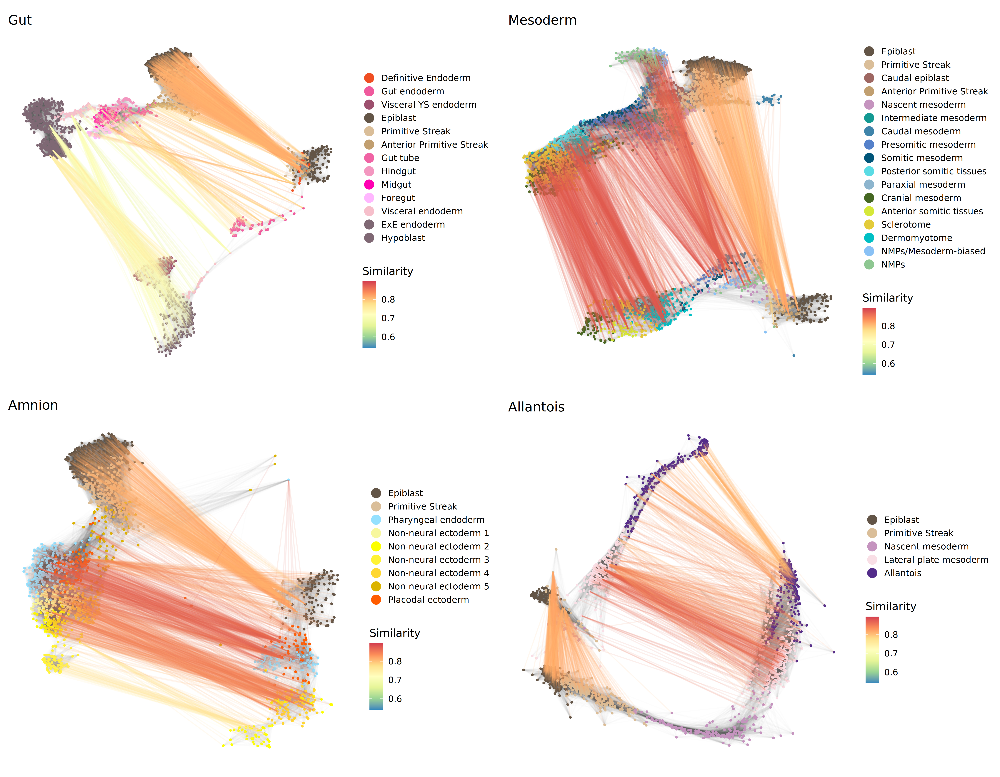

In [24]:
options(repr.plot.width = 18, repr.plot.height = 14, repr.plot.res = 300)
grid.arrange(p_gut, p_meso, p_amnion, p_allantois, nrow=2)

We can also visualise mappings using embeddings recomputed with just the subsetted cells/k-NN graph. 

In [21]:
r_meso <- scrabbitr::subsetMiloGroups(r_milo, "celltype", meso_celltypes)
m_meso <- scrabbitr::subsetMiloGroups(m_milo, "celltype", meso_celltypes)

In [22]:
r_meso <- runUMAP(r_meso, n_neighbors=50, min_dist=0.2, dimred = "PCA")
m_meso <- runUMAP(m_meso, n_neighbors=50, min_dist=0.2, dimred = "PCA")

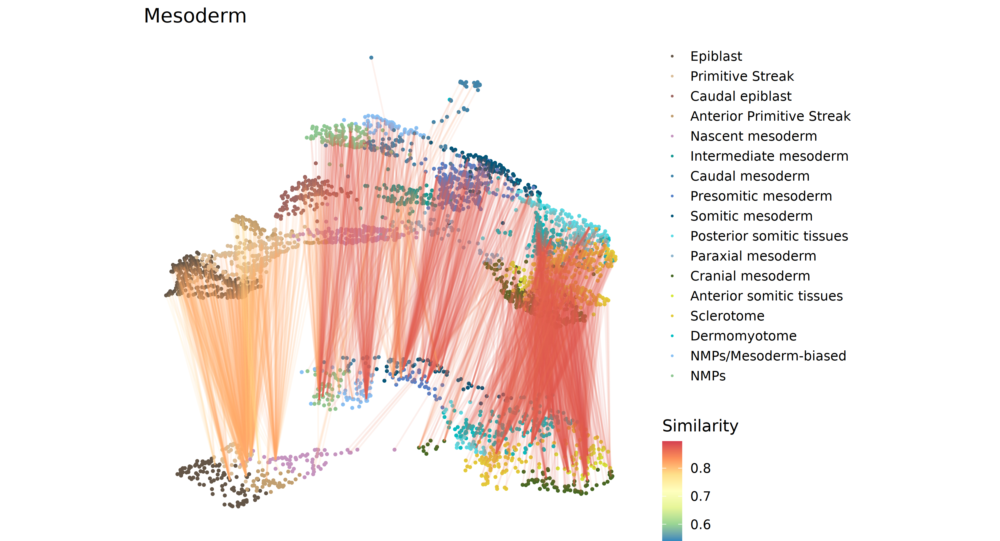

In [47]:
options(repr.plot.width = 12, repr.plot.height = 6.5, repr.plot.res = 300)

p <- plotNhoodMappings(r_meso, m_meso, df_simFilt, "UMAP", "celltype",
             offset=c(0,15), reflect.X=TRUE, line_alpha=0.1, edge_alpha=0, legend_pos="right") +
            guides(fill = guide_legend(override.aes = list(size=1))) + ggtitle("Mesoderm")

p

## Explore stage differences

For supplementary figure 7a, we explored diffences in developmental stage between neighbourhoods which are maximally correlated. 

In [66]:
df <- as.data.frame(r_maxNhoods)
map_stages <- cbind(r_maxNhoods, 
                    r_stage = colData(r_milo)[as.numeric(df[,1]), "stage"],
                    m_stage = colData(m_milo)[as.numeric(df[,2]), "stage"],
                    r_somites = colData(r_milo)[as.numeric(df[,1]), "somite_count"],
                    m_somites = colData(m_milo)[as.numeric(df[,2]), "somite_count"],
                    r_celltype = colData(r_milo)[as.numeric(df[,1]), "celltype"],
                   m_celltype = colData(m_milo)[as.numeric(df[,2]), "celltype"],
                   r_dissection = colData(r_milo)[as.numeric(df[,1]), "dissection"],
                   m_dissection = colData(m_milo)[as.numeric(df[,2]), "dissection"])

map_stages <- map_stages[map_stages$m_stage!="mixed_gastrulation",]

# Convert stages to numeric
stage_dict<- c("GD7"=7, "GD8"= 8, "GD9" = 9, 
               "E6.5"=6.5, "E6.75"=6.75, "E7.0"=7, "E7.25" = 7.25, "E7.5" = 7.5,
               "E7.75" = 7.75, "E8.0"=8, "E8.25" = 8.25, "E8.5" = 8.5, "E8.75" = 8.75,
               "E9.0" = 9, "E9.25" = 9.25, "E9.5" = 9.5)

map_stages$r_stage_num <- stage_dict[map_stages$r_stage]
map_stages$m_stage_num <- stage_dict[map_stages$m_stage]


# Compute difference in stage
map_stages$stage_diff <- abs(map_stages$r_stage_num - map_stages$m_stage_num)

# Add cell type mapping
map_stages$celltype_map <- paste0(map_stages$r_celltype, "-", map_stages$m_celltype)
map_stages$r_celltype_stage <- paste0(map_stages$r_celltype,"_",map_stages$r_stage_num)
map_stages$m_celltype_stage <- paste0(map_stages$m_celltype,"_",map_stages$m_stage_num)
map_stages$celltype_stage_map <- paste0(map_stages$r_celltype,"_",map_stages$r_stage_num, "-", map_stages$m_celltype,"_",map_stages$m_stage_num)

# Add cell type stage map frequency 
freqs <- table(map_stages$celltype_stage_map)
map_stages$n_celltype_stage_map <-  as.numeric(freqs[map_stages$celltype_stage_map])

head(map_stages)

nhoods1,nhoods2,sim,r_stage,m_stage,r_somites,m_somites,r_celltype,m_celltype,r_dissection,m_dissection,r_stage_num,m_stage_num,stage_diff,celltype_map,r_celltype_stage,m_celltype_stage,celltype_stage_map,n_celltype_stage_map
<int>,<int>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<dbl>
57511,84968,0.8742122,GD9,E8.5,13,Undetermined,Caudal mesoderm,Presomitic mesoderm,Posterior_section,Undetermined,9,8.5,0.5,Caudal mesoderm-Presomitic mesoderm,Caudal mesoderm_9,Presomitic mesoderm_8.5,Caudal mesoderm_9-Presomitic mesoderm_8.5,3
104077,84897,0.8709691,GD9,E8.5,11,Undetermined,Sclerotome,Sclerotome,EP,Undetermined,9,8.5,0.5,Sclerotome-Sclerotome,Sclerotome_9,Sclerotome_8.5,Sclerotome_9-Sclerotome_8.5,6
30659,109933,0.8386967,GD8,E8.5,4,Undetermined,MEP,MEP,Undetermined,Undetermined,8,8.5,0.5,MEP-MEP,MEP_8,MEP_8.5,MEP_8-MEP_8.5,13
19736,84145,0.7260434,GD8,E8.5,4,Undetermined,Hypoblast,ExE endoderm,Undetermined,Undetermined,8,8.5,0.5,Hypoblast-ExE endoderm,Hypoblast_8,ExE endoderm_8.5,Hypoblast_8-ExE endoderm_8.5,23
73244,358160,0.8724227,GD9,E8.5,16,7,Placodal ectoderm,Pharyngeal endoderm,Medial_section,Anterior,9,8.5,0.5,Placodal ectoderm-Pharyngeal endoderm,Placodal ectoderm_9,Pharyngeal endoderm_8.5,Placodal ectoderm_9-Pharyngeal endoderm_8.5,8
24387,98801,0.8131902,GD8,E8.0,4,Undetermined,Mesenchyme,Mesenchyme,Undetermined,Undetermined,8,8.0,0.0,Mesenchyme-Mesenchyme,Mesenchyme_8,Mesenchyme_8,Mesenchyme_8-Mesenchyme_8,61


<br>
We can plot which cell types/stages the rabbit gut tube neighbourhoods map to using an alluvial plot. This shows that a substantial number of rabbit GD9 gut tube neighbourhoods map to mouse gut tube neighbourhoods at day 8. 

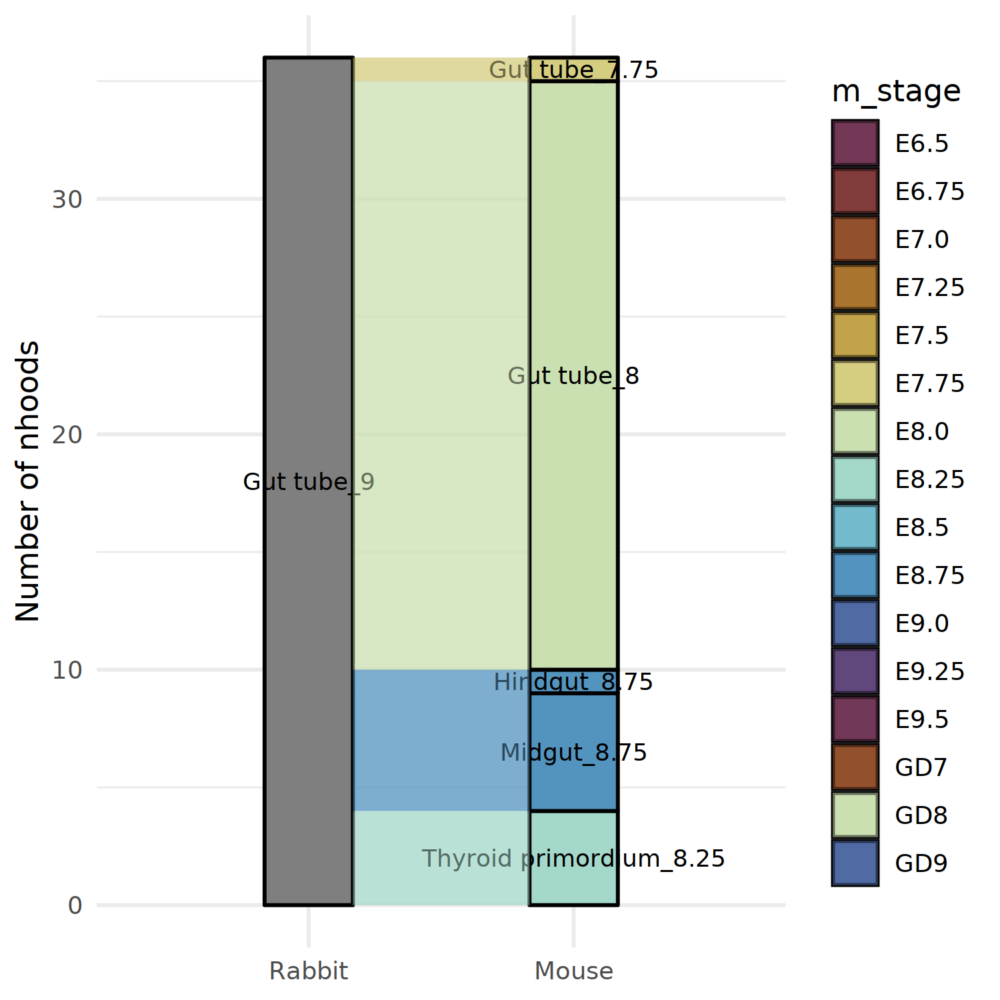

In [67]:
options(repr.plot.width = 5, repr.plot.height = 5, repr.plot.res = 300)

df <- map_stages[map_stages$r_celltype=="Gut tube"  ,]
df <- unique(df[,c('r_celltype','m_celltype',"n_celltype_stage_map","r_celltype_stage","m_celltype_stage","m_stage")])

p <- ggplot(df, aes(axis1 = r_celltype_stage, axis2=m_celltype_stage, y=n_celltype_stage_map, fill=m_stage)) +
    geom_alluvium() +  geom_stratum() + scale_fill_manual(values=scrabbitr::getStageColours()) +
    geom_text(stat = "stratum", aes(label = as.character(after_stat(stratum))),size=3) + 
    scale_x_discrete(limits = c("Rabbit", "Mouse"), expand = c(.4, 0.4)) +
    geom_flow() + theme_minimal() +
    ylab("Number of nhoods") 
p

#ggsave("../plots/compare_nhoods/gut_tube_stage_mapping.pdf", p, width=5, height=5, dpi=300)

## Export data

To interactively explore similarities between rabbit and mouse neighbourhoods, we created a 3D visualisation in javascript. To load the neighbourhood correlations into the javascript web app, we export the similarity matrices as a json files. We also export 3D UMAP coordinates and cell information as tsv files. 

You can see the web app running [here](https://crukci.shinyapps.io/scrabbit-shiny/)

In [31]:
# Load 3D umap
r_3d <- read.table("../data-in/rabbit/umap_3d.tsv",sep="\t",header=TRUE,row.names=1)
m_3d <- read.csv("../data-in/mouse/umap_3d.tsv",sep="\t",header=TRUE)

# Collating rabbit data
r_umap <- r_3d[as.numeric(vertex_attr(r_graph)$name),]
r_fa <- r_force[as.numeric(vertex_attr(r_graph)$name),]
r_celltype <- colData(r_milo)[as.numeric(vertex_attr(r_graph)$name), "celltype"]
celltype_colours <- scrabbitr::getCelltypeColours()

r_df <- data.frame(nhood = vertex_attr(r_graph)$name, 
                 index_cell = colnames(r_milo)[as.numeric(vertex_attr(r_graph)$name)],
                 umapX = r_umap$umapX, 
                 umapY = r_umap$umapY,
                 umapZ = r_umap$umapZ,
                faX = r_fa[,1],
                faY= r_fa[,2],
                 celltype = r_celltype,
                 colour = celltype_colours[r_celltype])

# Collating mouse data
m_umap <- m_3d[as.numeric(vertex_attr(m_graph)$name),]
m_celltype <- colData(m_milo)[as.numeric(vertex_attr(m_graph)$name), "celltype"]
m_fa <- m_force[as.numeric(vertex_attr(m_graph)$name),]

m_df <- data.frame(nhood = vertex_attr(m_graph)$name, 
                 index_cell = colnames(m_milo)[as.numeric(vertex_attr(m_graph)$name)] ,
                 umapX = m_umap$umapX, 
                 umapY = m_umap$umapY,
                umapZ = m_umap$umapZ,
                faX=m_fa[,1],
                faY=m_fa[,2],
                 celltype = m_celltype,
                 colour = celltype_colours[m_celltype])

# Export nhood information
write.table(r_df, "../data-out/compare_nhoods/export-js/rabbit_nhoods.tsv", sep="\t",quote=FALSE, row.names=FALSE, col.names=TRUE)
write.table(m_df, "../data-out/compare_nhoods/export-js/mouse_nhoods.tsv", sep="\t",quote=FALSE, row.names=FALSE, col.names=TRUE)

Here for each rabbit neighbourhood, we export it's top 5 most correlated mouse neighbourhoods (and the same vice-versa). 

In [134]:
getTopNhoods <- function(nhood_sim, N,margin=1) {
    sim_ordered <- t(apply(nhood_sim, margin, sort,decreasing=TRUE, index.return=TRUE))
    sim_topN <- lapply(sim_ordered, function(x) list(sim=x$x[1:N],index=x$ix[1:N]))
    if(margin==1) names(sim_topN) <- rownames(nhood_sim)
    else  names(sim_topN) <- colnames(nhood_sim)  
    return(sim_topN)
}

In [14]:
# Rabbit-mouse direction
nhoods_top <- getTopNhoods(nhood_sim,5)
names(nhoods_top) <- paste0("nhood_",names(nhoods_top))
nhoods_json <- toJSON(nhoods_top,pretty=TRUE, auto_unbox=TRUE)       

write(nhoods_json, "../data-out/compare_neighbourhoods/export-js/rm_nhood_sim.json")

In [135]:
# Mouse-rabbit direction
nhoods_top <- getTopNhoods(nhood_sim,5,margin=2)
names(nhoods_top) <- paste0("nhood_",names(nhoods_top))
nhoods_json <- toJSON(nhoods_top,pretty=TRUE, auto_unbox=TRUE)  

write(nhoods_json, "../data-out/compare_neighbourhoods/export-js/mr_nhood_sim.json")